Last updated: 15 Feb 2023

# 👋 PyCaret Regression Tutorial

PyCaret is an open-source, low-code machine learning library in Python that automates machine learning workflows. It is an end-to-end machine learning and model management tool that exponentially speeds up the experiment cycle and makes you more productive.

Compared with the other open-source machine learning libraries, PyCaret is an alternate low-code library that can be used to replace hundreds of lines of code with a few lines only. This makes experiments exponentially fast and efficient. PyCaret is essentially a Python wrapper around several machine learning libraries and frameworks, such as scikit-learn, XGBoost, LightGBM, CatBoost, spaCy, Optuna, Hyperopt, Ray, and a few more.

The design and simplicity of PyCaret are inspired by the emerging role of citizen data scientists, a term first used by Gartner. Citizen Data Scientists are power users who can perform both simple and moderately sophisticated analytical tasks that would previously have required more technical expertise.


In [2]:
import pycaret
from pycaret.datasets import get_data
from pycaret.regression import *
from pycaret.regression import RegressionExperiment

In [2]:
# check installed version (must be >3.0)
import pycaret
pycaret.__version__

'3.0.0'

# 🚀 Quick start

PyCaret's Regression Module is a supervised machine learning module that is used for estimating the relationships between a dependent variable (often called the outcome variable, or target) and one or more independent variables (often called features, predictors, or covariates). 

The objective of regression is to predict continuous values such as predicting sales amount, predicting quantity, predicting temperature, etc. Regression module provides several pre-processing features to preprocess the data for modeling through the setup function. 

PyCaret's regression module has many preprocessing capabilities and it coems with over 25 ready-to-use algorithms and several plots to analyze the performance of trained models. 

A typical workflow in PyCaret Regression module consist of the following 5 steps in this order:

### **Setup** ➡️ **Compare Models** ➡️ **Analyze Model** ➡️ **Prediction** ➡️ **Save Model** 
<br/>

In [7]:
import pandas as pd
from pycaret.regression import *
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
fp = 'C:/Users\PC/Mlops assignent/ds/data/01_hdb_resale_transactions.csv'

data = pd.read_csv(fp)

data.head()

,block,street_name,town,postal_code,month,flat_type,storey_range,floor_area_sqm,flat_model,lease_commence_date,resale_price,latitude,longitude,cbd_dist,min_dist_mrt
0,174,ANG MO KIO AVENUE 4,ANG MO KIO,560174,2015-01,3 ROOM,07 TO 09,60.0,Improved,1986,255000.0,1.375097,103.837619,10296.855750,1096.947897
1,541,ANG MO KIO AVENUE 10,ANG MO KIO,560541,2015-01,3 ROOM,01 TO 03,68.0,New Generation,1981,275000.0,1.373922,103.855621,10065.227930,847.235690
2,163,ANG MO KIO AVENUE 4,ANG MO KIO,560163,2015-01,3 ROOM,01 TO 03,69.0,New Generation,1980,285000.0,1.373552,103.838169,10118.831550,1176.742184
3,446,ANG MO KIO AVENUE 10,ANG MO KIO,560446,2015-01,3 ROOM,01 TO 03,68.0,New Generation,1979,290000.0,1.367761,103.855357,9383.300907,682.205473
4,557,ANG MO KIO AVENUE 10,ANG MO KIO,560557,2015-01,3 ROOM,07 TO 09,68.0,New Generation,1980,290000.0,1.371626,103.857736,9825.917255,953.047695


## Exploratory data analysis

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 194240 entries, 0 to 194239
Data columns (total 15 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   block                194240 non-null  object 
 1   street_name          194240 non-null  object 
 2   town                 194240 non-null  object 
 3   postal_code          194240 non-null  int64  
 4   month                194240 non-null  object 
 5   flat_type            194240 non-null  object 
 6   storey_range         194240 non-null  object 
 7   floor_area_sqm       194240 non-null  float64
 8   flat_model           194240 non-null  object 
 9   lease_commence_date  194240 non-null  int64  
 10  resale_price         194240 non-null  float64
 11  latitude             194240 non-null  float64
 12  longitude            194240 non-null  float64
 13  cbd_dist             194240 non-null  float64
 14  min_dist_mrt         194240 non-null  float64
dtypes: float64(6), in

In [5]:
print("\nSummary Statistics:")
print(data.describe())


Summary Statistics:
         postal_code  floor_area_sqm  lease_commence_date  resale_price  \
count  194240.000000   194240.000000        194240.000000  1.942400e+05   
mean   559367.576117       97.384379          1994.774820  4.752727e+05   
std    190231.706479       24.072589            13.448988  1.629553e+05   
min     50004.000000       31.000000          1966.000000  1.400000e+05   
25%    510139.000000       82.000000          1984.000000  3.570000e+05   
50%    560534.000000       94.000000          1995.000000  4.420000e+05   
75%    730022.000000      112.000000          2004.000000  5.600000e+05   
max    825195.000000      280.000000          2019.000000  1.500000e+06   

            latitude      longitude       cbd_dist   min_dist_mrt  
count  194240.000000  194240.000000  194240.000000  194240.000000  
mean        1.367260     103.841397   12418.365399     826.191306  
std         0.042700       0.071485    4403.239962     461.936681  
min         1.270380     103.64

In [6]:
data.isnull().sum()

block                  0
street_name            0
town                   0
postal_code            0
month                  0
flat_type              0
storey_range           0
floor_area_sqm         0
flat_model             0
lease_commence_date    0
resale_price           0
latitude               0
longitude              0
cbd_dist               0
min_dist_mrt           0
dtype: int64

In [7]:
# Show value counts for categorical columns
categorical_columns = ['street_name', 'town', 'month', 'flat_type', 'storey_range', 'flat_model']
for column in categorical_columns:
    print(f"\nValue counts for column '{column}':")
    print(data[column].value_counts())



Value counts for column 'street_name':
YISHUN RING ROAD         2930
BEDOK RESERVOIR ROAD     2210
PUNGGOL DRIVE            2014
ANG MO KIO AVENUE 10     1977
PUNGGOL FIELD            1931
                         ... 
KRETA AYER ROAD             6
SEMBAWANG WAY               3
ALJUNIED AVENUE 2           1
GEYLANG EAST AVENUE 2       1
MARINE PARADE CENTRAL       1
Name: street_name, Length: 572, dtype: int64

Value counts for column 'town':
SENGKANG           15812
WOODLANDS          13663
PUNGGOL            13222
TAMPINES           13193
JURONG WEST        13192
YISHUN             12939
BEDOK              10892
HOUGANG             9619
CHOA CHU KANG       8953
ANG MO KIO          8368
BUKIT MERAH         7371
BUKIT PANJANG       7343
BUKIT BATOK         6996
TOA PAYOH           6100
PASIR RIS           5989
KALLANG/WHAMPOA     5864
QUEENSTOWN          5399
SEMBAWANG           5028
GEYLANG             4925
CLEMENTI            4520
JURONG EAST         4066
SERANGOON           3723
BI

In [8]:
# Display basic information about the dataset
print("Basic Information:")
print(data.info())

Basic Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 194240 entries, 0 to 194239
Data columns (total 15 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   block                194240 non-null  object 
 1   street_name          194240 non-null  object 
 2   town                 194240 non-null  object 
 3   postal_code          194240 non-null  int64  
 4   month                194240 non-null  object 
 5   flat_type            194240 non-null  object 
 6   storey_range         194240 non-null  object 
 7   floor_area_sqm       194240 non-null  float64
 8   flat_model           194240 non-null  object 
 9   lease_commence_date  194240 non-null  int64  
 10  resale_price         194240 non-null  float64
 11  latitude             194240 non-null  float64
 12  longitude            194240 non-null  float64
 13  cbd_dist             194240 non-null  float64
 14  min_dist_mrt         194240 non-null  float64
dty

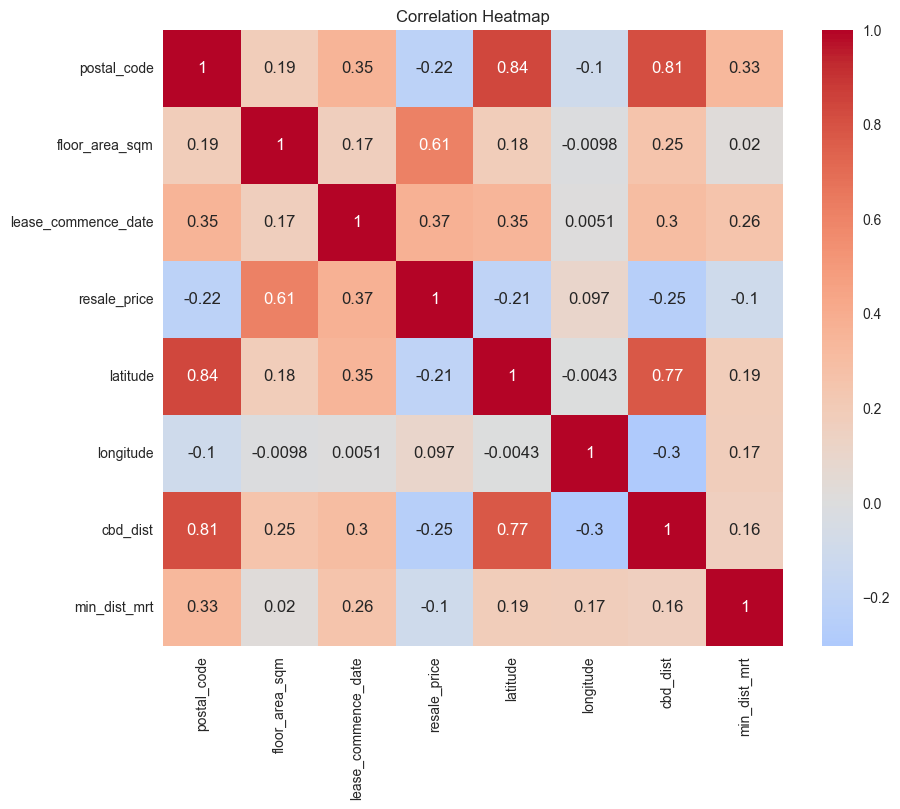

In [9]:
# Create a heatmap to visualize correlations between numerical variables
correlation_matrix = data.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title("Correlation Heatmap")
plt.show()

<Figure size 2000x800 with 0 Axes>

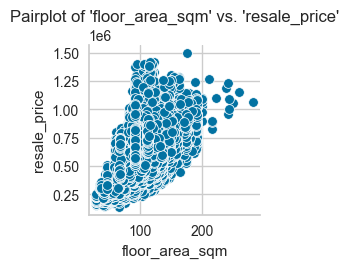

<Figure size 2000x800 with 0 Axes>

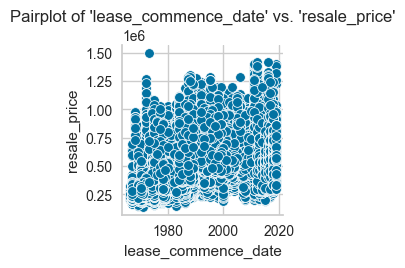

<Figure size 2000x800 with 0 Axes>

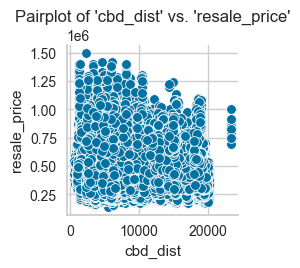

<Figure size 2000x800 with 0 Axes>

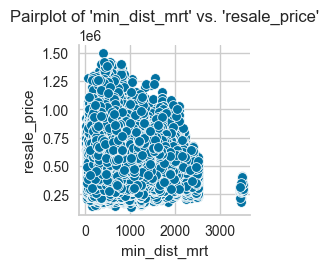

In [10]:
# Select the numerical variables for pairplot
numerical_columns = ['floor_area_sqm', 'lease_commence_date', 'cbd_dist', 'min_dist_mrt']

# Create pairplots for each numerical variable and target variable ('resale_price')
for column in numerical_columns:
    plt.figure(figsize=(20, 8))
    sns.pairplot(data, x_vars=column, y_vars='resale_price', kind='scatter')
    plt.title(f"Pairplot of '{column}' vs. 'resale_price'")
    plt.xlabel(column)
    plt.ylabel('resale_price')
    plt.show()


From this incredibly lackluster analysis,

higher Floor area = higher resale price


mrt and cbd distance - closer more expensive

Possible: later flats are sold at a higher price


In [11]:
import pandas as pd

# Calculate the correlation coefficient between lease_commence_date and resale_price
correlation_coefficient = data['lease_commence_date'].corr(data['resale_price'])

print(f"Correlation Coefficient between Lease Commence Date and Resale Price: {correlation_coefficient:.4f}")


Correlation Coefficient between Lease Commence Date and Resale Price: 0.3728


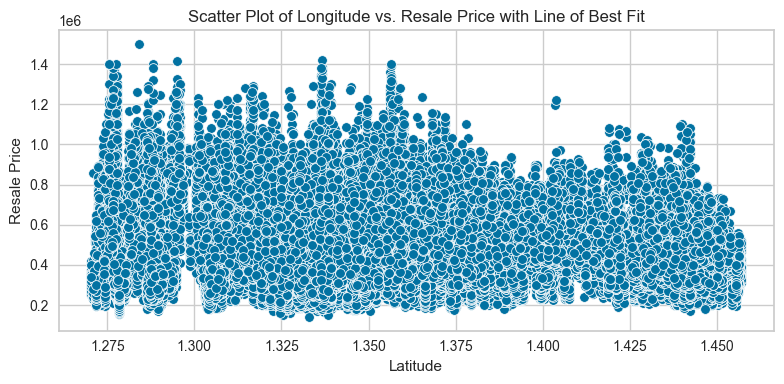

In [12]:

# Create a scatter plot of latitude vs. resale_price
plt.figure(figsize=(8, 4))
sns.scatterplot(x='latitude', y='resale_price', data=data)
plt.title("Scatter Plot of Longitude vs. Resale Price with Line of Best Fit")
plt.xlabel("Latitude")
plt.ylabel("Resale Price")
plt.tight_layout()
plt.show()


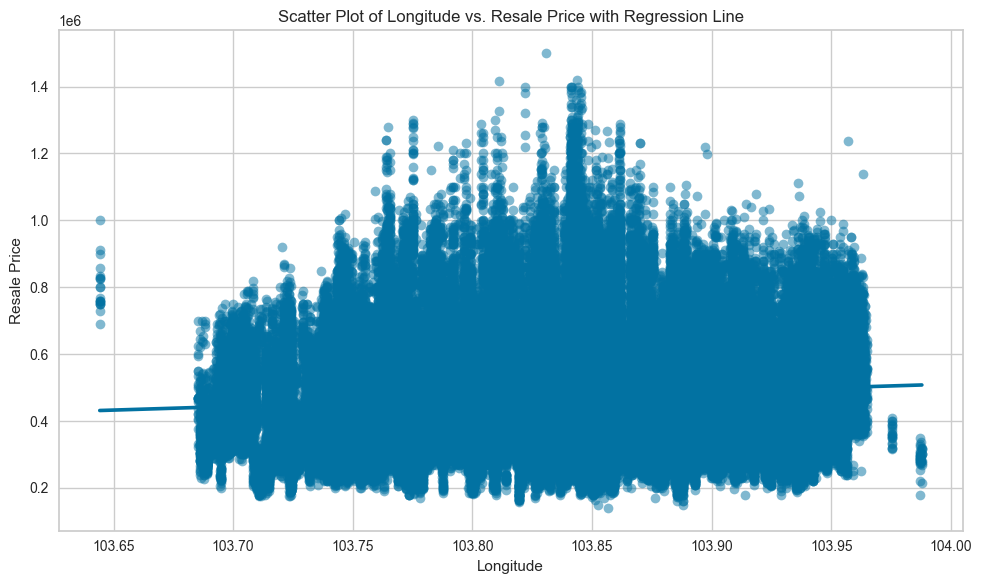

In [13]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Create a scatter plot of longitude vs. resale_price with a regression line
plt.figure(figsize=(10, 6))
sns.regplot(x='longitude', y='resale_price', data=data, scatter_kws={'alpha':0.5})
plt.title("Scatter Plot of Longitude vs. Resale Price with Regression Line")
plt.xlabel("Longitude")
plt.ylabel("Resale Price")
plt.tight_layout()
plt.show()


In [14]:
# plot scatter carat_weight and Price
import plotly.express as px
fig = px.scatter(x=data['floor_area_sqm'], y=data['resale_price'], opacity = 0.25, trendline='ols', trendline_color_override = 'red')

fig.show()


In [15]:
#Let’s check the histogram of the target variable Price.
# plot histogram 
fig = px.histogram(data, x=["resale_price"]) 
fig.show()



Little to no correlation between these two variables

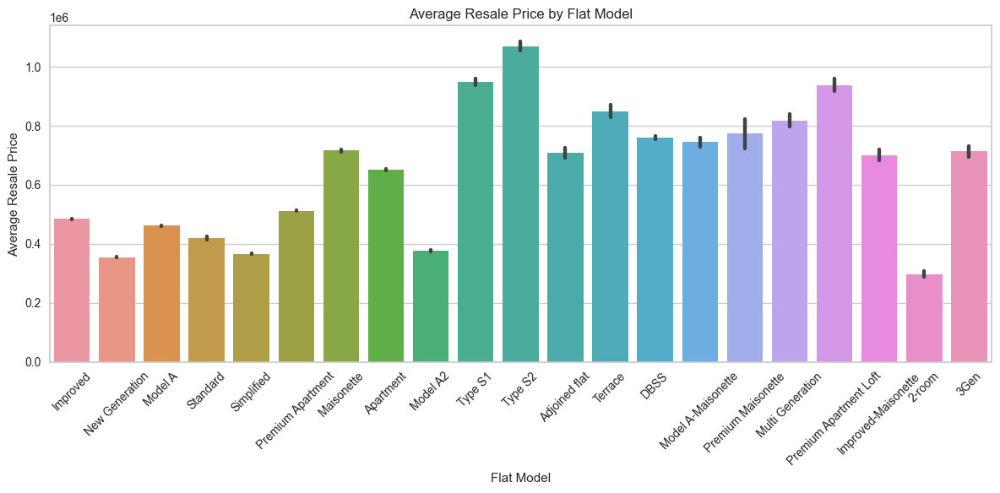

In [16]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Create a bar plot of flat_model vs. resale_price
plt.figure(figsize=(12, 6))
sns.barplot(x='flat_model', y='resale_price', data=data)
plt.xticks(rotation=45)
plt.title("Average Resale Price by Flat Model")
plt.xlabel("Flat Model")
plt.ylabel("Average Resale Price")
plt.tight_layout()
plt.show()


flat model for categorical features

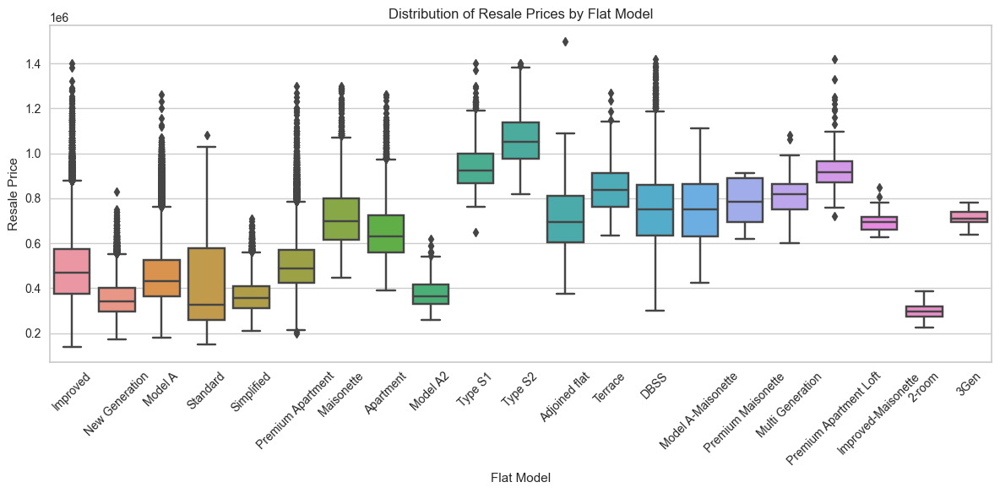

In [17]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# Create a box plot of flat_model vs. resale_price
plt.figure(figsize=(12, 6))
sns.boxplot(x='flat_model', y='resale_price', data=data)
plt.xticks(rotation=45)
plt.title("Distribution of Resale Prices by Flat Model")
plt.xlabel("Flat Model")
plt.ylabel("Resale Price")
plt.tight_layout()
plt.show()


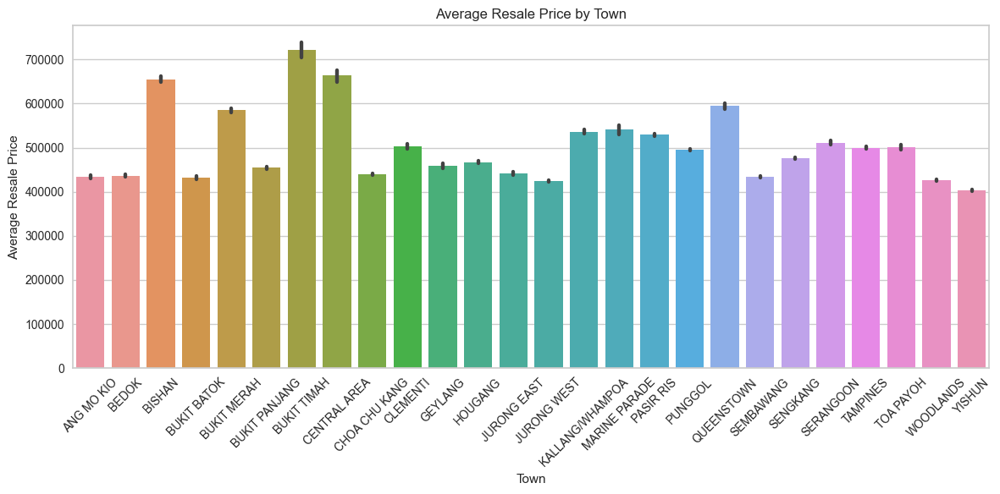

In [18]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Create a bar plot of town vs. resale_price
plt.figure(figsize=(12, 6))
sns.barplot(x='town', y='resale_price', data=data)
plt.xticks(rotation=45)
plt.title("Average Resale Price by Town")
plt.xlabel("Town")
plt.ylabel("Average Resale Price")
plt.tight_layout()
plt.show()


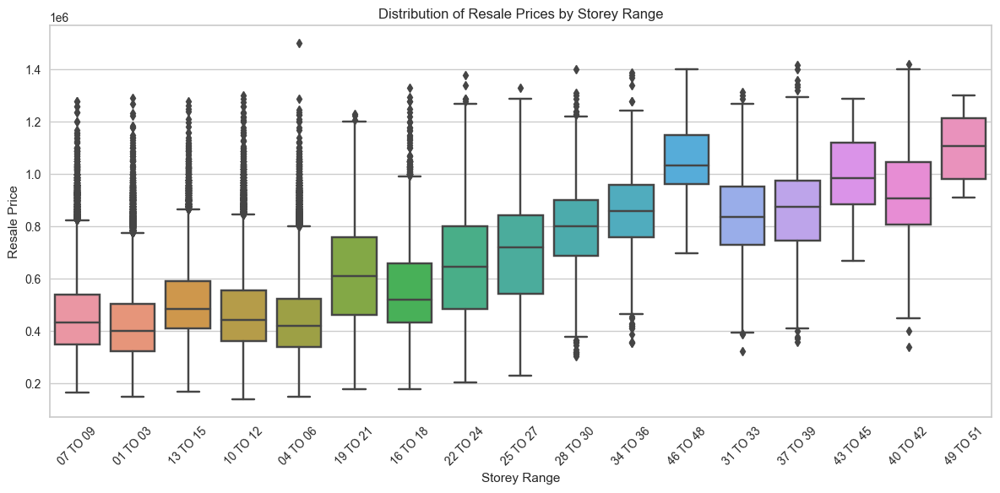

In [19]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Create a box plot of storey_range vs. resale_price
plt.figure(figsize=(12, 6))
sns.boxplot(x='storey_range', y='resale_price', data=data)
plt.xticks(rotation=45)
plt.title("Distribution of Resale Prices by Storey Range")
plt.xlabel("Storey Range")
plt.ylabel("Resale Price")
plt.tight_layout()
plt.show()


Seems resale prices are more expesnive when higher floors on average

guess this calls for ordinal encoding

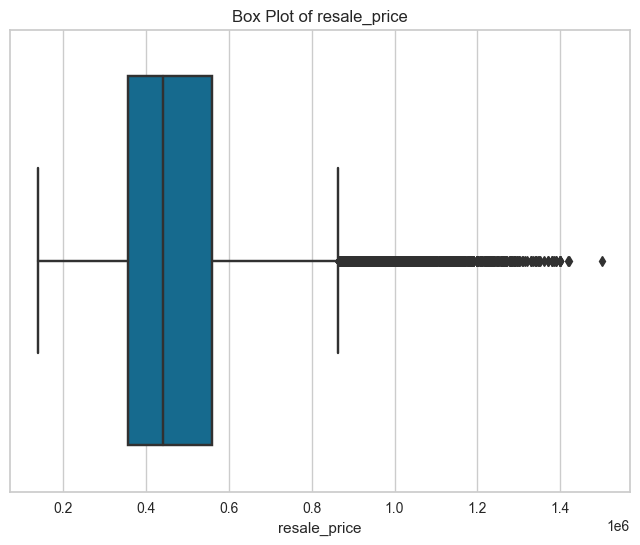

Identified Outliers:


,block,street_name,town,postal_code,month,flat_type,storey_range,floor_area_sqm,flat_model,lease_commence_date,resale_price,latitude,longitude,cbd_dist,min_dist_mrt
347,1C,CANTONMENT ROAD,CENTRAL AREA,85301,2015-01,5 ROOM,31 TO 33,106.0,Type S2,2011,980000.0,1.277449,103.841667,1235.378296,357.252623
1301,1A,CANTONMENT ROAD,CENTRAL AREA,85101,2015-02,5 ROOM,37 TO 39,107.0,Type S2,2011,1030000.0,1.277843,103.840966,1283.717649,284.078089
1306,1C,CANTONMENT ROAD,CENTRAL AREA,85301,2015-02,5 ROOM,28 TO 30,107.0,Type S2,2011,991000.0,1.277449,103.841667,1235.378296,357.252623
1309,1B,CANTONMENT ROAD,CENTRAL AREA,85201,2015-02,5 ROOM,22 TO 24,105.0,Type S2,2011,1000000.0,1.277799,103.841403,1242.492320,309.092462
1310,1B,CANTONMENT ROAD,CENTRAL AREA,85201,2015-02,5 ROOM,43 TO 45,105.0,Type S2,2011,1040000.0,1.277799,103.841403,1242.492320,309.092462
1403,9,HOLLAND AVENUE,QUEENSTOWN,272009,2015-02,5 ROOM,22 TO 24,147.0,Adjoined flat,1974,985000.0,1.307556,103.794444,6885.599005,485.451556
1716,3,TOH YI DRIVE,BUKIT TIMAH,590003,2015-02,EXECUTIVE,10 TO 12,146.0,Maisonette,1988,980000.0,1.338774,103.775254,10471.876090,241.515310
2491,1C,CANTONMENT ROAD,CENTRAL AREA,85301,2015-03,5 ROOM,31 TO 33,105.0,Type S2,2011,973888.0,1.277449,103.841667,1235.378296,357.252623
2493,1B,CANTONMENT ROAD,CENTRAL AREA,85201,2015-03,5 ROOM,22 TO 24,107.0,Type S2,2011,1018000.0,1.277799,103.841403,1242.492320,309.092462
3290,53,JALAN MA'MOR,KALLANG/WHAMPOA,320053,2015-03,3 ROOM,01 TO 03,280.0,Terrace,1972,1060000.0,1.328279,103.856097,5035.054478,1061.633999


In [20]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats


column_to_check = 'resale_price'

# Create a box plot to visualize the distribution and potential outliers
plt.figure(figsize=(8, 6))
sns.boxplot(x=data[column_to_check])
plt.title(f'Box Plot of {column_to_check}')
plt.show()

# Calculate Z-scores for the column
z_scores = stats.zscore(data[column_to_check])

# Set a Z-score threshold for identifying outliers (e.g., 3 or -3)
z_score_threshold = 3

# Identify data points with Z-scores beyond the threshold
outliers = data[abs(z_scores) > z_score_threshold]

# Print the identified outliers
print("Identified Outliers:")
outliers.head(10)


In [21]:
data['resale_price'].min()

140000.0

In [22]:
data['resale_price'].max()

1500000.0

Im assuming a price range of 140000 - 1500000 is not realyl considered an outlier for houses so nt gonna remove outleirs

Theres also this EDA

## ✅ EDA
This function generates automated Exploratory Data Analysis (EDA) using the `AutoViz` library. You must install Autoviz separately pip install autoviz to use this function. For more information check out [AutoViz.](https://github.com/AutoViML/AutoViz)|

In [23]:
# eda function

## Model and setup

In [24]:
data.head(2)

,block,street_name,town,postal_code,month,flat_type,storey_range,floor_area_sqm,flat_model,lease_commence_date,resale_price,latitude,longitude,cbd_dist,min_dist_mrt
0,174,ANG MO KIO AVENUE 4,ANG MO KIO,560174,2015-01,3 ROOM,07 TO 09,60.0,Improved,1986,255000.0,1.375097,103.837619,10296.85575,1096.947897
1,541,ANG MO KIO AVENUE 10,ANG MO KIO,560541,2015-01,3 ROOM,01 TO 03,68.0,New Generation,1981,275000.0,1.373922,103.855621,10065.22793,847.235690


In [25]:
import mlflow
mlflow.set_tracking_uri("http://localhost:5000")

with mlflow.start_run():
    print(mlflow.get_artifact_uri())
#     The mlflow part

file:///C:/Users/PC/Mlops%20assignent/ds/notebooks/mlruns/0/c61bed126ca54c68a973ccae40843772/artifacts


In [8]:
# Set up the environment
# remove the columns which are pretty useless for the model ['block','street_name','postal_code', 'month']
# oridnal encoding for storey range
# Log_experiment set to true
# Enable cross validation
s = setup(data=data, target='resale_price', transform_target = True, log_experiment = True, experiment_name = 'price_prediction',ignore_features = ['town','block','street_name','postal_code', 'month'], ordinal_features = {'storey_range' : ['low', 'medium', 'high']}, categorical_features = ['flat_type', 'flat_model'])

,Description,Value
0,Session id,877
1,Target,resale_price
2,Target type,Regression
3,Original data shape,"(194240, 15)"
4,Transformed data shape,"(194240, 36)"
5,Transformed train set shape,"(135968, 36)"
6,Transformed test set shape,"(58272, 36)"
7,Ignore features,5
8,Ordinal features,1
9,Numeric features,6


In [27]:
# import RegressionExperiment and init the class
from pycaret.regression import RegressionExperiment
exp = RegressionExperiment()

In [28]:
# check the type of exp
type(exp)

pycaret.regression.oop.RegressionExperiment

## Compare Models

The `compare_models` function trains and evaluates the performance of all the estimators available in the model library using cross-validation. The output of this function is a scoring grid with average cross-validated scores. Metrics evaluated during CV can be accessed using the `get_metrics` function. Custom metrics can be added or removed using `add_metric` and `remove_metric` function.

In [29]:
# init setup on exp
exp.setup(data, target = 'resale_price', session_id = 123)

,Description,Value
0,Session id,123
1,Target,resale_price
2,Target type,Regression
3,Original data shape,"(194240, 15)"
4,Transformed data shape,"(194240, 57)"
5,Transformed train set shape,"(135968, 57)"
6,Transformed test set shape,"(58272, 57)"
7,Numeric features,7
8,Categorical features,7
9,Preprocess,True


In [30]:
# compare baseline models
best = compare_models()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
catboost,CatBoost Regressor,39941.8203,2863934338.9837,53513.4463,0.8916,0.1094,0.0853,4.2080
xgboost,Extreme Gradient Boosting,40377.6375,2922949913.6000,54061.3324,0.8894,0.1104,0.0861,2.2070
lightgbm,Light Gradient Boosting Machine,41623.8650,3086446306.6813,55553.0848,0.8832,0.1127,0.0886,0.4730
rf,Random Forest Regressor,42140.6588,3213113344.3496,56681.8541,0.8784,0.1165,0.0902,6.7040
et,Extra Trees Regressor,43078.2436,3401414683.1635,58319.0712,0.8712,0.1195,0.0921,4.1290
dt,Decision Tree Regressor,43613.6242,3516221207.3688,59294.7309,0.8669,0.1211,0.0932,0.4310
knn,K Neighbors Regressor,45274.9562,3767629184.0000,61377.2855,0.8574,0.1259,0.0968,1.3980
gbr,Gradient Boosting Regressor,47492.2512,4006221688.5184,63293.2612,0.8483,0.1255,0.1000,2.6800
ridge,Ridge Regression,56443.3990,5865446108.1026,76521.3386,0.7780,0.1478,0.1185,0.3180
br,Bayesian Ridge,56442.3222,5868763639.7085,76541.7914,0.7779,0.1478,0.1185,0.4690


Processing:   0%|          | 0/85 [00:00<?, ?it/s]

In [31]:
# compare models using OOP
exp.compare_models()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
catboost,CatBoost Regressor,23416.9956,1009143312.2219,31763.2256,0.9621,0.0682,0.0520,4.8020
lightgbm,Light Gradient Boosting Machine,25067.0341,1150222024.0229,33913.2755,0.9568,0.0707,0.0546,0.5720
xgboost,Extreme Gradient Boosting,26121.5268,1279174092.8000,35753.0914,0.9520,0.0742,0.0571,3.9870
et,Extra Trees Regressor,33782.2008,1963922328.3945,44314.6603,0.9263,0.0969,0.0768,13.6500
gbr,Gradient Boosting Regressor,32868.4005,2071419553.8500,45510.0983,0.9223,0.0901,0.0698,6.6830
lr,Linear Regression,43089.2783,3206110161.9686,56620.7226,0.8797,0.1334,0.0960,0.5230
lasso,Lasso Regression,43090.5510,3206185382.7475,56621.3816,0.8797,0.1335,0.0960,4.2580
ridge,Ridge Regression,43088.5332,3206128475.3839,56620.8815,0.8797,0.1334,0.0960,0.3330
br,Bayesian Ridge,43088.8334,3206112124.4165,56620.7386,0.8797,0.1334,0.0960,0.7250
llar,Lasso Least Angle Regression,43103.8098,3207887931.6833,56636.2373,0.8796,0.1336,0.0961,0.3550


Processing:   0%|          | 0/85 [00:00<?, ?it/s]

## Analyze Model

The `plot_model` function is used to analyze the performance of a trained model on the test set. It may require re-training the model in certain cases.

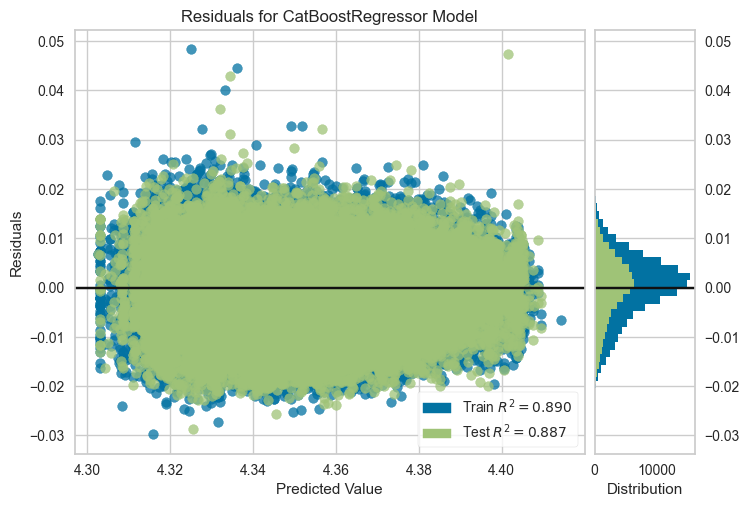

In [32]:
# plot residuals
plot_model(best, plot = 'residuals')

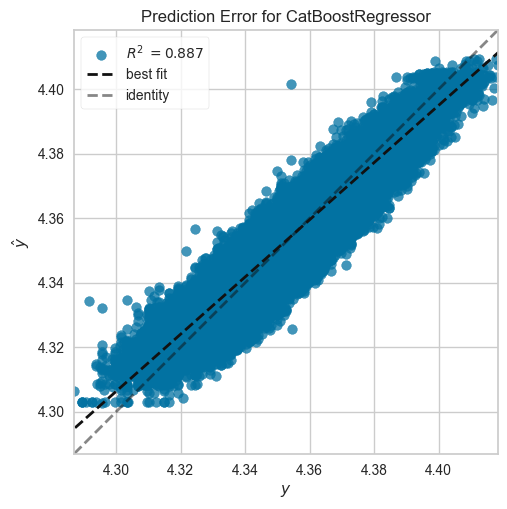

In [33]:
# plot error
plot_model(best, plot = 'error')

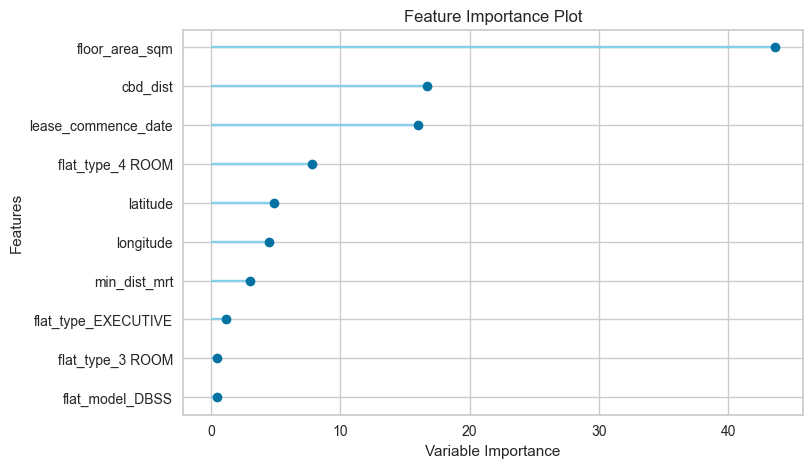

In [34]:
# plot feature importance
plot_model(best, plot = 'feature')

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

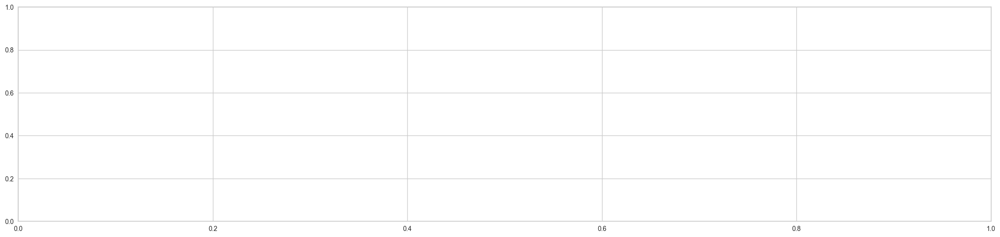

In [35]:
evaluate_model(best)

## ✅ Interpret Model

The `interpret_model` function analyzes the predictions generated from a trained model. Most plots in this function are implemented based on the SHAP (Shapley Additive exPlanations). For more info on this, please see https://shap.readthedocs.io/en/latest/

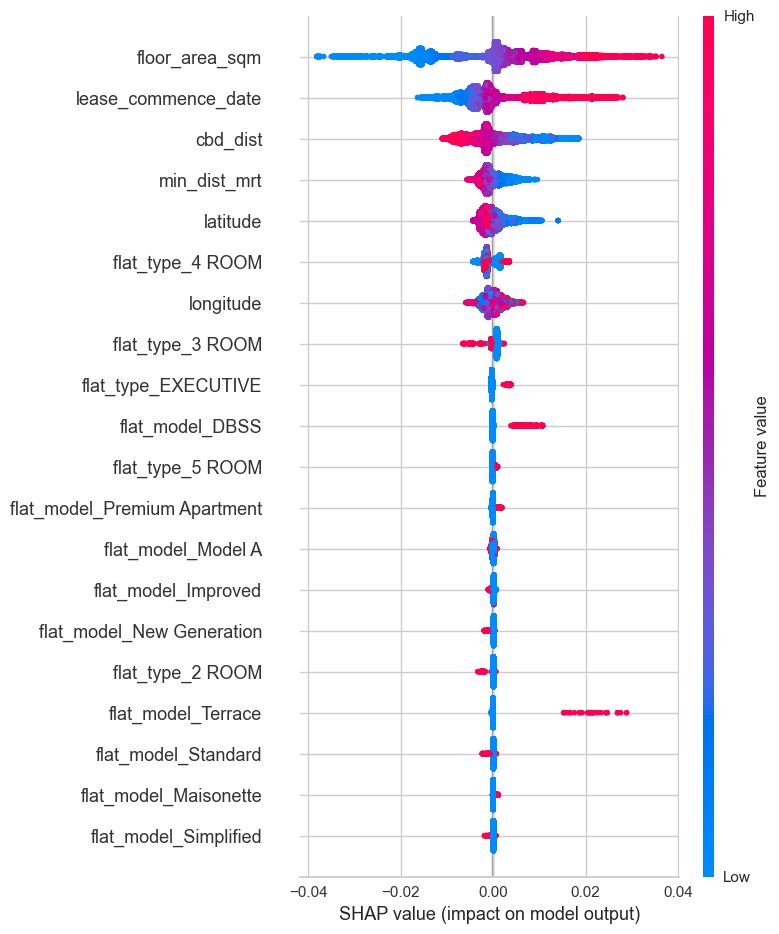

In [36]:
# interpret summary model
interpret_model(best, plot = 'summary')

In [37]:
# reason plot for test set observation 1
interpret_model(best, plot = 'reason', observation = 1)

___

## Prediction


In [38]:
# predict on test set
holdout_pred = predict_model(best)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,CatBoost Regressor,472483.1799,247063826152.9934,497055.1540,-633484328163698.5000,11.3425,108315.1804


In [39]:
# s.predict_model(best)

In [40]:
# show predictions df
holdout_pred.head()

,flat_type,storey_range,floor_area_sqm,flat_model,lease_commence_date,latitude,longitude,cbd_dist,min_dist_mrt,resale_price,prediction_label
190966,5 ROOM,10 TO 12,118.0,Improved,1976,1.313807,103.896912,6113.100098,642.282349,766000.0,671390.955432
183094,3 ROOM,07 TO 09,67.0,New Generation,1980,1.380201,103.835754,10886.292969,1040.755249,350000.0,293800.661955
86869,4 ROOM,04 TO 06,114.0,Model A,1996,1.428370,103.773758,18244.054688,460.402161,344000.0,394138.342719
74894,4 ROOM,10 TO 12,105.0,Model A,1993,1.379914,103.740463,16339.493164,742.841187,340000.0,360528.317097
66633,5 ROOM,13 TO 15,110.0,Premium Apartment,2004,1.388429,103.874321,11936.012695,2180.578613,448000.0,463106.095479


The same function works for predicting the labels on unseen dataset. Let's create a copy of original data and drop the `resale_price`. We can then use the new data frame without labels for scoring.

In [41]:
# copy data and drop the target variable
new_data = data.copy()
new_data.drop('resale_price', axis=1, inplace=True)
new_data.head()

,block,street_name,town,postal_code,month,flat_type,storey_range,floor_area_sqm,flat_model,lease_commence_date,latitude,longitude,cbd_dist,min_dist_mrt
0,174,ANG MO KIO AVENUE 4,ANG MO KIO,560174,2015-01,3 ROOM,07 TO 09,60.0,Improved,1986,1.375097,103.837619,10296.855750,1096.947897
1,541,ANG MO KIO AVENUE 10,ANG MO KIO,560541,2015-01,3 ROOM,01 TO 03,68.0,New Generation,1981,1.373922,103.855621,10065.227930,847.235690
2,163,ANG MO KIO AVENUE 4,ANG MO KIO,560163,2015-01,3 ROOM,01 TO 03,69.0,New Generation,1980,1.373552,103.838169,10118.831550,1176.742184
3,446,ANG MO KIO AVENUE 10,ANG MO KIO,560446,2015-01,3 ROOM,01 TO 03,68.0,New Generation,1979,1.367761,103.855357,9383.300907,682.205473
4,557,ANG MO KIO AVENUE 10,ANG MO KIO,560557,2015-01,3 ROOM,07 TO 09,68.0,New Generation,1980,1.371626,103.857736,9825.917255,953.047695


In [42]:
# predict model on new_data
predictions = predict_model(best, data = new_data)
predictions.head()

,block,street_name,town,postal_code,month,flat_type,storey_range,floor_area_sqm,flat_model,lease_commence_date,latitude,longitude,cbd_dist,min_dist_mrt,prediction_label
0,174,ANG MO KIO AVENUE 4,ANG MO KIO,560174,2015-01,3 ROOM,07 TO 09,60.0,Improved,1986,1.375098,103.837616,10296.855469,1096.947876,286095.001037
1,541,ANG MO KIO AVENUE 10,ANG MO KIO,560541,2015-01,3 ROOM,01 TO 03,68.0,New Generation,1981,1.373922,103.855621,10065.227539,847.235718,296089.837958
2,163,ANG MO KIO AVENUE 4,ANG MO KIO,560163,2015-01,3 ROOM,01 TO 03,69.0,New Generation,1980,1.373552,103.838165,10118.832031,1176.742188,303013.897621
3,446,ANG MO KIO AVENUE 10,ANG MO KIO,560446,2015-01,3 ROOM,01 TO 03,68.0,New Generation,1979,1.367761,103.855354,9383.300781,682.205444,297074.993258
4,557,ANG MO KIO AVENUE 10,ANG MO KIO,560557,2015-01,3 ROOM,07 TO 09,68.0,New Generation,1980,1.371626,103.857735,9825.916992,953.047668,296002.582414


## Save Model

save the entire pipeline on disk for later use, using pycaret's `save_model` function.

In [43]:
# save pipeline
save_model(best, 'my_third_pipeline')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=FastMemory(location=C:\Users\PC\AppData\Local\Temp\joblib),
          steps=[('target_transformation',
                  TransformerWrapperWithInverse(transformer=TargetTransformer(estimator=PowerTransformer(standardize=False)))),
                 ('numerical_imputer',
                  TransformerWrapper(include=['floor_area_sqm',
                                              'lease_commence_date', 'latitude',
                                              'longitude', 'cbd_dist',
                                              'min_dist_mr...
                                                                mapping=[{'col': 'storey_range',
                                                                          'data_type': dtype('O'),
                                                                          'mapping': low       0
 medium    1
 high      2
 NaN      -1
 dtype: int64}]))),
                 ('onehot_encoding',
                  TransformerWrapper(include=[

In [3]:
# load pipeline
loaded_best_pipeline = load_model('my_third_pipeline')
loaded_best_pipeline

Transformation Pipeline and Model Successfully Loaded


Pipeline(memory=FastMemory(location=C:\Users\PC\AppData\Local\Temp\joblib),
         steps=[('target_transformation',
                 TransformerWrapperWithInverse(transformer=TargetTransformer(estimator=PowerTransformer(standardize=False)))),
                ('numerical_imputer',
                 TransformerWrapper(include=['floor_area_sqm',
                                             'lease_commence_date', 'latitude',
                                             'longitude', 'cbd_dist',
                                             'min_dist_mr...
                                                               mapping=[{'col': 'storey_range',
                                                                         'data_type': dtype('O'),
                                                                         'mapping': low       0
medium    1
high      2
NaN      -1
dtype: int64}]))),
                ('onehot_encoding',
                 TransformerWrapper(include=['flat_type', 'flat_model'],
                                    transformer=OneHotEncoder(cols=['flat_type',
                                                                    'flat_model'],
                                                              handle_missing='return_nan',
                                                              use_cat_names=True))),
                ('trained_model',
                 <catboost.core.CatBoostRegressor object at 0x000001BEFA02DB80>)])

In [ ]:
# import mlflow
# logged_model = 'my_sec_pipeline.pkl'

# # Load model as a PyFuncModel.
# loaded_model = mlflow.pyfunc.load_model(logged_model)

# # Predict on a Pandas DataFrame.
# import pandas as pd
# loaded_model.predict(pd.DataFrame(data))

## ✅ AutoML
This function returns the best model out of all trained models in the current setup based on the optimize parameter. Metrics evaluated can be accessed using the `get_metrics` function.

In [46]:
# find best model based on CV metrics
automl()

## ✅ Dashboard
The dashboard function generates the interactive dashboard for a trained model. The dashboard is implemented using `ExplainerDashboard`. For more information check out [Explainer Dashboard.](explainerdashboard.readthedocs.io)

In [ ]:
# dashboard function
dashboard(best, display_format ='inline')

## ✅Create App
This function creates a basic gradio app for inference.

In [9]:
# create gradio app
# Use this function to automacitcally create an using gradio
create_app(loaded_best_pipeline)

Running on local URL:  http://127.0.0.1:7860

To create a public link, set `share=True` in `launch()`.


## ✅ EDA
This function generates automated Exploratory Data Analysis (EDA) using the `AutoViz` library. You must install Autoviz separately pip install autoviz to use this function. For more information check out [AutoViz.](https://github.com/AutoViML/AutoViz)|

In [ ]:
# eda function
eda()

## ✅ Create API
This function takes an input model and creates a POST API for inference.

In [4]:
# create api
create_api(best, api_name = 'my_first_api')

NameError: name 'best' is not defined

In [ ]:
!python my_first_api.py

In [ ]:
# check out the .py file created with this magic command
# %load my_first_api.py

## ✅ Create Docker
This function creates a `Dockerfile` and `requirements.txt` for productionalizing API end-point.

In [ ]:
create_docker('my_first_api')

In [ ]:
# check out the DockerFile file created with this magic command
# %load DockerFile

In [ ]:
# check out the requirements file created with this magic command
# %load requirements.txt

## ✅ Finalize Model
This function trains a given model on the entire dataset including the hold-out set.

In [ ]:
final_best = finalize_model(best)

In [ ]:
final_best

## ✅ Deploy Model
This function deploys the entire ML pipeline on the cloud.

**AWS:**  When deploying model on AWS S3, environment variables must be configured using the command-line interface. To configure AWS environment variables, type `aws configure` in terminal. The following information is required which can be generated using the Identity and Access Management (IAM) portal of your amazon console account:

- AWS Access Key ID
- AWS Secret Key Access
- Default Region Name (can be seen under Global settings on your AWS console)
- Default output format (must be left blank)

**GCP:** To deploy a model on Google Cloud Platform ('gcp'), the project must be created using the command-line or GCP console. Once the project is created, you must create a service account and download the service account key as a JSON file to set environment variables in your local environment. Learn more about it: https://cloud.google.com/docs/authentication/production

**Azure:** To deploy a model on Microsoft Azure ('azure'), environment variables for the connection string must be set in your local environment. Go to settings of storage account on Azure portal to access the connection string required.
AZURE_STORAGE_CONNECTION_STRING (required as environment variable)
Learn more about it: https://docs.microsoft.com/en-us/azure/storage/blobs/storage-quickstart-blobs-python?toc=%2Fpython%2Fazure%2FTOC.json

In [ ]:
# deploy model on aws s3
# deploy_model(best, model_name = 'my_first_platform_on_aws',
#             platform = 'aws', authentication = {'bucket' : 'pycaret-test'})

In [ ]:
# load model from aws s3
# loaded_from_aws = load_model(model_name = 'my_first_platform_on_aws', platform = 'aws',
#                              authentication = {'bucket' : 'pycaret-test'})

# loaded_from_aws

## ✅ Save / Load Experiment
This function saves all the experiment variables on disk, allowing to later resume without rerunning the setup function.

In [ ]:
# save experiment
save_experiment('my_experiment')

In [ ]:
# load experiment from disk
exp_from_disk = load_experiment('my_experiment', data=data)